In [ ]:
import sys

sys.path.append("../..")

import pandas as pd
import numpy as np

import matplotlib as mpl
import matplotlib.pyplot as plt
import geopandas as gp
import seaborn as sns

import src.datasets.loading.ookla
import src.datasets.loading.statcan
import src.datasets.joins

from src.config import DATA_DIRECTORY

/Users/zacharyshand/.local/lib/python3.10/site-packages/requests/__init__.py:109: RequestsDependencyWarning: urllib3 (1.26.9) or chardet (5.1.0)/charset_normalizer (2.0.12) doesn't match a supported version!
  warnings.warn(


In [10]:
# Load Data and Inspect Content

In [ ]:
das_info = gp.read_file(DATA_DIRECTORY / "hackathon" / "geometry.gpkg", driver="GPKG")
speed_data = pd.read_csv(DATA_DIRECTORY / "hackathon" / "speeds.csv")
speed_data.DAUID = speed_data.DAUID.astype(str)

In [1]:
print("Hello")

Hello


In [3]:
das_info.loc[:, ["PRUID", "PRNAME"]].drop_duplicates()

,PRUID,PRNAME
0,10,Newfoundland and Labrador / Terre-Neuve-et-Lab...
820,11,Prince Edward Island / Île-du-Prince-Édouard
826,12,Nova Scotia / Nouvelle-Écosse
1799,13,New Brunswick / Nouveau-Brunswick
2807,24,Quebec / Québec
16337,35,Ontario
37111,46,Manitoba
38389,47,Saskatchewan
41251,48,Alberta
47302,59,British Columbia / Colombie-Britannique


In [4]:
das_info.info()

<class 'geopandas.geodataframe.GeoDataFrame'>
RangeIndex: 56589 entries, 0 to 56588
Data columns (total 54 columns):
 #   Column                             Non-Null Count  Dtype   
---  ------                             --------------  -----   
 0   DAUID                              56589 non-null  object  
 1   PRUID                              56589 non-null  object  
 2   PRNAME                             56589 non-null  object  
 3   CDUID                              56589 non-null  object  
 4   CDNAME                             56589 non-null  object  
 5   CDTYPE                             56589 non-null  object  
 6   CCSUID                             56589 non-null  object  
 7   CCSNAME                            56589 non-null  object  
 8   CSDUID                             56589 non-null  object  
 9   CSDNAME                            56589 non-null  object  
 10  CSDTYPE                            56589 non-null  object  
 11  ERUID                            

# Demonstrate Basic Geopandas Plotting
The `explore` function generates interactive (JS-based) mapping. It can be slow if too much content 
is rendered (e.g. whole country). The matplotlib `plot` function has many similar arguments 
and is faster and less resource intensive inside a notebook environment.

In [12]:
# The PCCLASS splits urban/rural areas of the country
# The PRUID is an ID for different provinces.
das_info.loc[lambda s: s.PRUID == "48"].explore(
    column="PCCLASS",
    tooltip=["PCCLASS", "DAUID", "Pop_2021", "PCNAME", "CDNAME"],
    popup=False,
)

# Aggregate Data and Compare Over Time

In [6]:
# Add dates for plotting
full_data = pd.merge(das_info, speed_data)
full_data["date"] = pd.to_datetime(
    full_data["year"].astype(str)
    + "-"
    + ((full_data["quarter"] - 1) * 3 + 1).astype(str)
    + "-01"
)

In [7]:
# Look at statistics from particular cities
calgary_edmonton_avg_d_kbps = (
    full_data.loc[lambda s: s.PCNAME.isin(["Calgary", "Edmonton"])]
    .groupby(["PCNAME", "year", "quarter"])["avg_d_kbps"]
    .aggregate(["mean", "std", "min", "max"])
).reset_index()
calgary_edmonton_avg_d_kbps["date"] = pd.to_datetime(
    calgary_edmonton_avg_d_kbps["year"].astype(str)
    + "-"
    + ((calgary_edmonton_avg_d_kbps["quarter"] - 1) * 3 + 1).astype(str)
    + "-01"
)
calgary_edmonton_avg_d_kbps

,PCNAME,year,quarter,mean,std,min,max,date
0,Calgary,2019,1,100435.783052,48010.233544,162.0,554719.0,2019-01-01
1,Calgary,2019,2,106797.181026,54944.183893,17.0,605889.0,2019-04-01
2,Calgary,2019,3,103409.917330,47027.075159,118.0,437692.0,2019-07-01
3,Calgary,2019,4,111916.628759,51070.855608,52.0,503773.0,2019-10-01
4,Calgary,2020,1,114299.150983,49609.178289,193.0,510157.0,2020-01-01
5,Calgary,2020,2,121940.746970,55186.145875,58.0,577982.0,2020-04-01
6,Calgary,2020,3,117533.857017,50023.054660,87.0,442587.0,2020-07-01
7,Calgary,2020,4,138831.303694,60977.463773,462.0,615662.0,2020-10-01
8,Calgary,2021,1,153009.023423,63249.454112,939.0,492154.0,2021-01-01
9,Calgary,2021,2,163894.500128,72610.473648,314.0,641328.0,2021-04-01


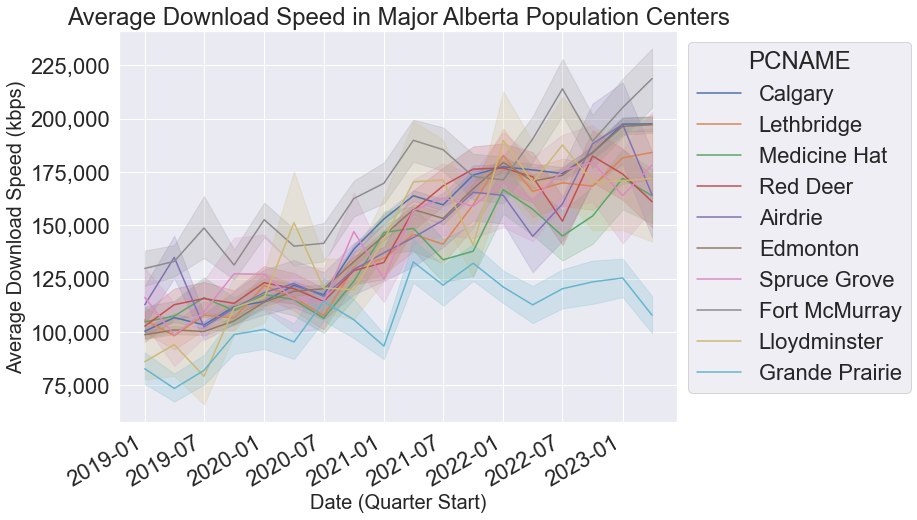

In [8]:
sns.set(font_scale=2)
# sns.lineplot(x="date", y="avg_d_kbps", hue='PCNAME', data=full_data.loc[lambda s:s.PCNAME.isin(["Calgary","Edmonton"])])
sns.lineplot(
    x="date",
    y="avg_d_kbps",
    hue="PCNAME",
    data=full_data.loc[lambda s: (s.PRUID == "48") & (s.PCCLASS.isin(["3", "4"]))],
)

plt.gcf().set_size_inches(10, 8)
plt.xlabel("Date (Quarter Start)", fontsize=20)
plt.ylabel("Average Download Speed (kbps)", fontsize=20)
plt.gcf().autofmt_xdate()

plt.gca().yaxis.set_major_formatter(mpl.ticker.StrMethodFormatter("{x:,.0f}"))
sns.move_legend(plt.gca(), "upper left", bbox_to_anchor=(1, 1))
plt.gca().set(title="Average Download Speed in Major Alberta Population Centers");

# Consider Spread Across Regions
Use most recent quarterly information as basis for spread in speeds.

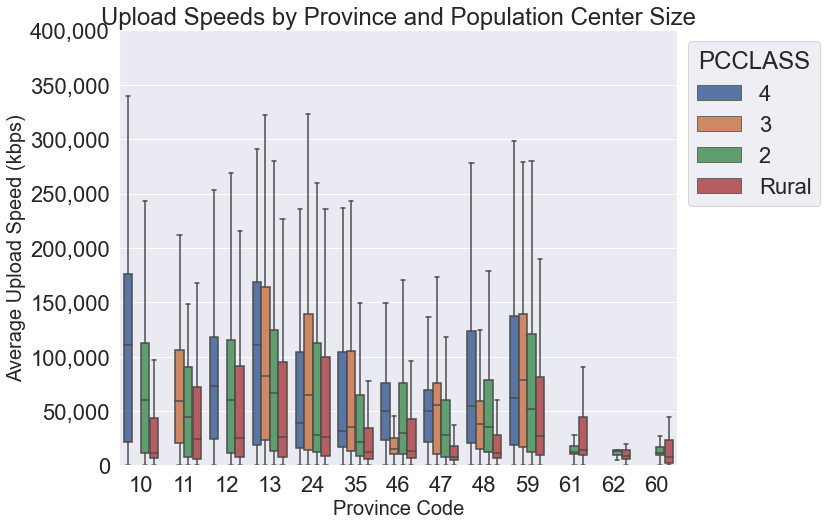

In [9]:
sns.boxplot(
    x="PRUID",
    y="avg_u_kbps",
    hue="PCCLASS",
    fliersize=0,
    hue_order=["4", "3", "2", "Rural"],
    data=full_data.fillna(value={"PCCLASS": "Rural"}).loc[
        lambda s: (s.year == 2023) & (s.quarter == 2)
    ],
)
plt.gcf().set_size_inches(10, 8)
sns.move_legend(plt.gca(), "upper left", bbox_to_anchor=(1, 1))
plt.gca().yaxis.set_major_formatter(mpl.ticker.StrMethodFormatter("{x:,.0f}"))
plt.xlabel("Province Code", fontsize=20)
plt.ylabel("Average Upload Speed (kbps)", fontsize=20)
plt.gca().set_ylim(0, 400_000)
plt.gca().set(title="Upload Speeds by Province and Population Center Size");